## Loss Cover Month Matrix

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

%matplotlib inline

In [2]:
basins_org = pd.read_csv('../data/variables/FCL316Basins.csv', error_bad_lines = False, 
                         sep = ';')

In [3]:
basins_org.head(10)

,cod_ah,cod_szh,cod_zh,nom_ah,nom_szh,nom_zh,objectid_1,ruleid,shape_area,shape_leng,...,FCL 2010 (% acum),FCL 2011 (% acum),FCL 2012 (% acum),FCL 2013 (% acum),FCL 2014 (% acum),FCL 2015 (% acum),FCL 2016 (% acum),FCL 2017 (% acum),FCL 2018 (% acum),FCL 2019 (% acum)
0,1,1701,17,Caribe,San Andres,Islas Caribe,1,2,0.002232,0.358011,...,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%
1,1,1702,17,Caribe,Providencia,Islas Caribe,2,2,0.001842,0.294393,...,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%
2,1,1703,17,Caribe,Roncador y Quitasue?o,Islas Caribe,3,2,0.002260,0.341056,...,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%,0.000%
3,2,2602,26,Magdalena Cauca,R?o Palac?,Cauca,4,3,0.075834,1.709663,...,3.945%,4.670%,5.534%,5.675%,5.953%,6.140%,6.365%,6.955%,7.206%,7.442%
4,2,2606,26,Magdalena Cauca,R?o Ovejas,Cauca,5,3,0.075015,1.398528,...,2.530%,3.153%,3.709%,3.842%,4.031%,4.119%,4.366%,4.853%,4.913%,5.234%
5,2,2604,26,Magdalena Cauca,R?o Palo,Cauca,6,3,0.134115,2.115094,...,1.337%,1.468%,1.851%,1.894%,1.955%,1.967%,1.986%,2.008%,2.026%,2.048%
6,2,2607,26,Magdalena Cauca,R?o Guachal (Bolo - Fraile y P?rraga),Cauca,7,3,0.096384,1.672267,...,1.492%,1.629%,1.856%,1.941%,2.119%,2.137%,2.190%,2.199%,2.204%,2.223%
7,2,2632,26,Magdalena Cauca,"R?os Guabas,Sabaletas y Sonso",Cauca,8,3,0.045246,1.027300,...,2.418%,2.750%,2.944%,3.058%,3.221%,3.276%,3.530%,3.630%,3.646%,3.709%
8,2,2609,26,Magdalena Cauca,R?os Amaime y Cerrito,Cauca,9,3,0.091403,1.708338,...,1.923%,2.134%,2.313%,2.392%,2.547%,2.571%,2.667%,2.780%,2.813%,2.906%
9,2,2633,26,Magdalena Cauca,R?os Guadalajara y San Pedro,Cauca,10,3,0.037664,1.341142,...,1.400%,1.569%,1.859%,1.966%,2.380%,2.421%,2.498%,2.546%,2.559%,2.595%


In [4]:
basins_org.columns

Index(['cod_ah', 'cod_szh', 'cod_zh', 'nom_ah', 'nom_szh', 'nom_zh',
       'objectid_1', 'ruleid', 'shape_area', 'shape_leng', 'HISTO_0',
       'HISTO_1', 'HISTO_2', 'HISTO_3', 'HISTO_4', 'HISTO_5', 'HISTO_6',
       'HISTO_7', 'HISTO_8', 'HISTO_9', 'HISTO_10', 'HISTO_11', 'HISTO_12',
       'HISTO_13', 'HISTO_14', 'HISTO_15', 'HISTO_16', 'HISTO_17', 'HISTO_18',
       'HISTO_19', 'Area Cuenca (ha)', 'FCL 2001 (ha)', 'FCL 2002 (ha)',
       'FCL 2003 (ha)', 'FCL 2004 (ha)', 'FCL 2005 (ha)', 'FCL 2006 (ha)',
       'FCL 2007 (ha)', 'FCL 2008 (ha)', 'FCL 2009 (ha)', 'FCL 2010 (ha)',
       'FCL 2011 (ha)', 'FCL 2012 (ha)', 'FCL 2013 (ha)', 'FCL 2014 (ha)',
       'FCL 2015 (ha)', 'FCL 2016 (ha)', 'FCL 2017 (ha)', 'FCL 2018 (ha)',
       'FCL 2019 (ha)', 'FCL 2001 (%)', 'FCL 2002 (%)', 'FCL 2003 (%)',
       'FCL 2004 (%)', 'FCL 2005 (%)', 'FCL 2006 (%)', 'FCL 2007 (%)',
       'FCL 2008 (%)', 'FCL 2009 (%)', 'FCL 2010 (%)', 'FCL 2011 (%)',
       'FCL 2012 (%)', 'FCL 2013 (%)', 'FCL 20

In [5]:
basins_org.dtypes

cod_ah                int64
cod_szh               int64
cod_zh                int64
nom_ah               object
nom_szh              object
                      ...  
FCL 2015 (% acum)    object
FCL 2016 (% acum)    object
FCL 2017 (% acum)    object
FCL 2018 (% acum)    object
FCL 2019 (% acum)    object
Length: 88, dtype: object

### Basins descriptions

In [6]:
basins_descr = basins_org[['objectid_1', 'cod_ah', 'nom_ah', 'cod_szh', 'nom_szh', 
                           'cod_zh', 'nom_zh', 'ruleid', 'shape_area', 'shape_leng', 
                           'Area Cuenca (ha)']].copy()

basins_descr.columns = ['basin_id', 'cod_ah', 'nom_ah', 'cod_szh', 'nom_szh', 
                        'cod_zh', 'nom_zh', 'ruleid', 'shape_area', 'shape_leng', 
                        'basin_area']

basins_descr.head()

,basin_id,cod_ah,nom_ah,cod_szh,nom_szh,cod_zh,nom_zh,ruleid,shape_area,shape_leng,basin_area
0,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774
1,2,1,Caribe,1702,Providencia,17,Islas Caribe,2,0.001842,0.294393,2207.014
2,3,1,Caribe,1703,Roncador y Quitasue?o,17,Islas Caribe,2,0.002260,0.341056,2696.730
3,4,2,Magdalena Cauca,2602,R?o Palac?,26,Cauca,3,0.075834,1.709663,93254.343
4,5,2,Magdalena Cauca,2606,R?o Ovejas,26,Cauca,3,0.075015,1.398528,92229.766


### Year Month Sequence 

In [7]:
month_seq = pd.date_range(start = '1/1/2000', end = '31/12/2019', freq = 'M')

month_seq = pd.DataFrame(month_seq)
month_seq.columns = ['date']

month_seq['year'] = pd.DatetimeIndex(month_seq['date']).year
month_seq['month'] = pd.DatetimeIndex(month_seq['date']).month

print(month_seq.dtypes)

month_seq.tail()

date     datetime64[ns]
year              int64
month             int64
dtype: object


,date,year,month
235,2019-08-31,2019,8
236,2019-09-30,2019,9
237,2019-10-31,2019,10
238,2019-11-30,2019,11
239,2019-12-31,2019,12


### Variable HISTO 

In [8]:
basins_histo_hz = basins_org[['objectid_1', 'HISTO_0', 'HISTO_1', 'HISTO_2', 'HISTO_3', 
                              'HISTO_4', 'HISTO_5', 'HISTO_6', 'HISTO_7', 'HISTO_8', 
                              'HISTO_9', 'HISTO_10', 'HISTO_11', 'HISTO_12', 'HISTO_13', 
                              'HISTO_14', 'HISTO_15', 'HISTO_16', 'HISTO_17', 'HISTO_18',
                              'HISTO_19']]

basins_histo_hz.columns = ['basin_id', '2000', '2001', '2002', '2003', '2004', '2005', 
                           '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', 
                           '2014', '2015', '2016', '2017', '2018', '2019']

basins_histo_hz.head()

,basin_id,2000,2001,2002,2003,2004,2005,2006,2007,2008,...,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,3,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,4,1122387,8104,3127,3625,4918,6631,4022,3285,4008,...,3701,8854,10564,1733,3391,2289,2749,7217,3066,2882
4,5,1136949,6565,3532,1636,3837,3662,2644,1091,3172,...,841,7522,6728,1605,2285,1069,2990,5887,720,3885


In [9]:
basins_histo = pd.melt(basins_histo_hz, id_vars = ['basin_id'], 
                       value_vars = ['2000', '2001', '2002', '2003', '2004', '2005', 
                                     '2006', '2007', '2008', '2009', '2010', '2011', 
                                     '2012', '2013', '2014', '2015', '2016', '2017', 
                                     '2018', '2019']).copy()

basins_histo.columns = ['basin_id', 'year', 'loss_cover']

print(basins_histo)

      basin_id  year  loss_cover
0            1  2000           0
1            2  2000           0
2            3  2000           0
3            4  2000     1122387
4            5  2000     1136949
...        ...   ...         ...
6315       312  2019        3161
6316       313  2019         124
6317       314  2019          15
6318       315  2019           0
6319       316  2019           0

[6320 rows x 3 columns]


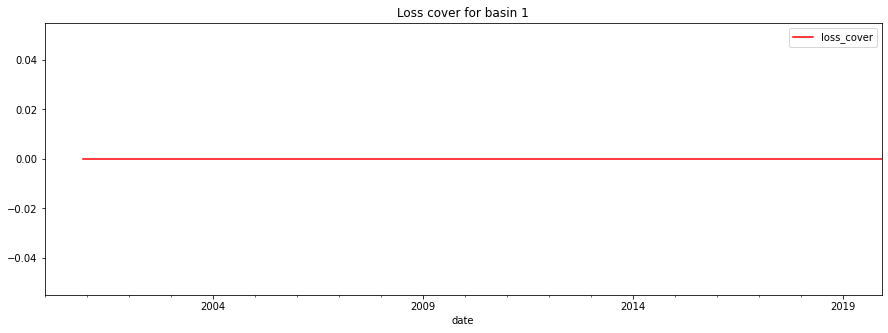

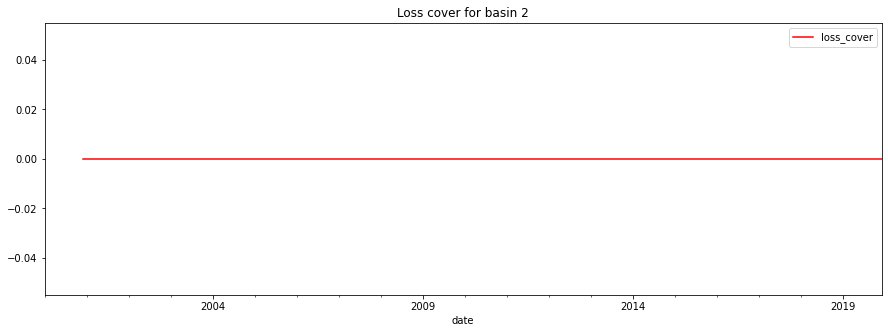

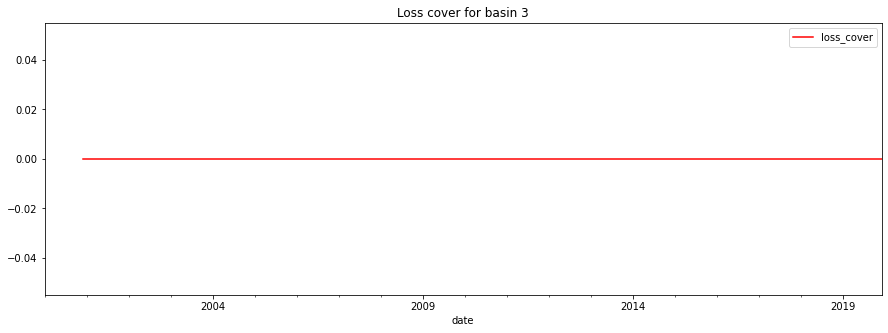

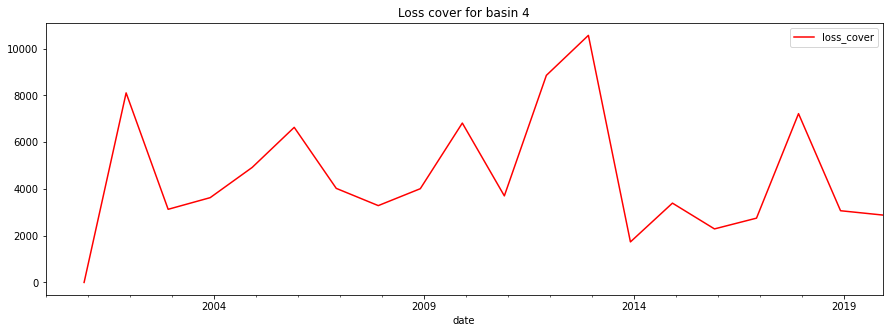

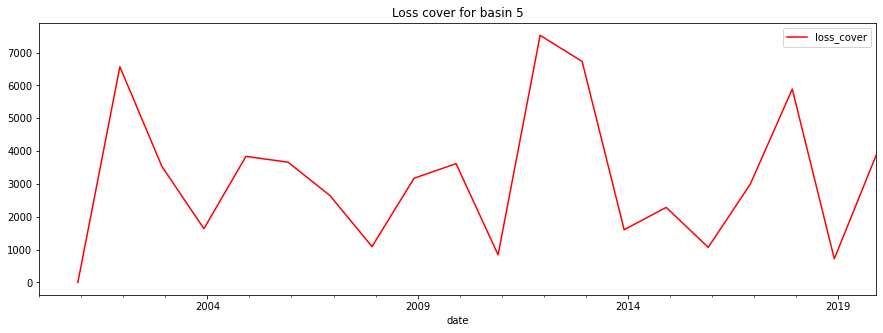

...

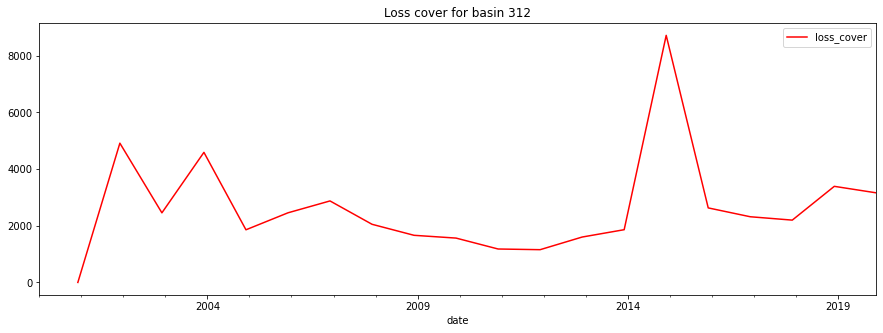

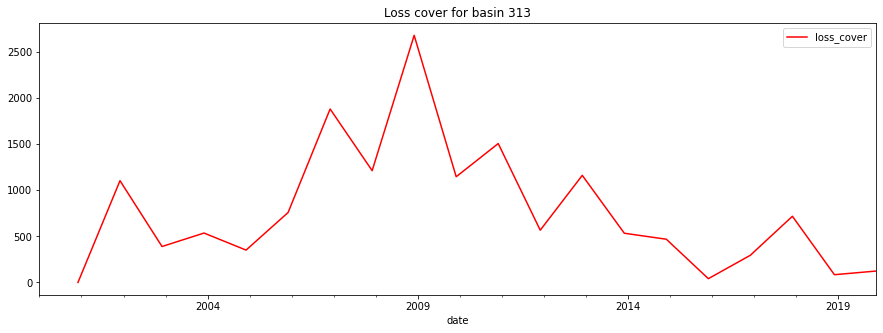

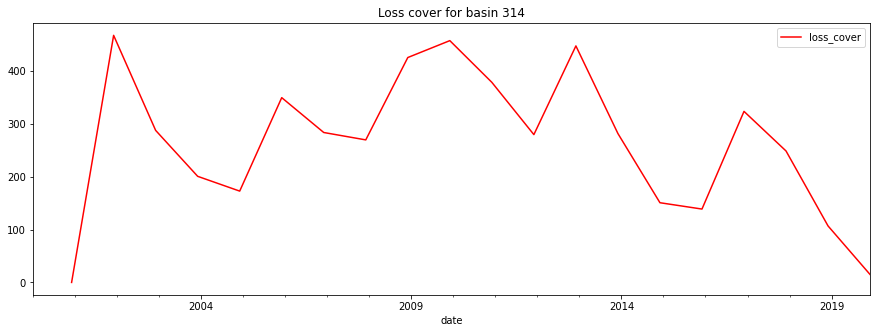

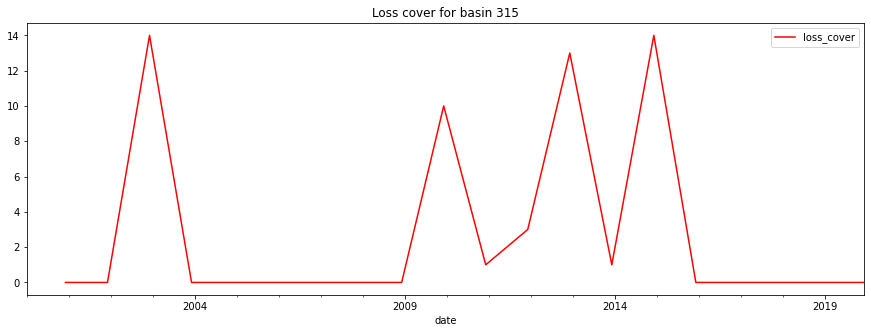

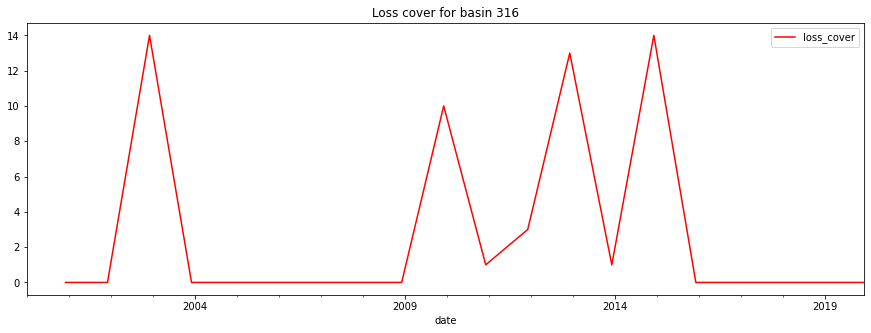

            basin_id  year  loss_cover  month         type
date                                                      
2000-01-31         1  2000         NaN      1  interpolate
2000-02-29         1  2000         NaN      2  interpolate
2000-03-31         1  2000         NaN      3  interpolate
2000-04-30         1  2000         NaN      4  interpolate
2000-05-31         1  2000         NaN      5  interpolate


In [10]:
temp_df = basins_histo
temp_df['basin_id'] = pd.to_numeric(temp_df['basin_id'])
temp_df['year'] = pd.to_numeric(temp_df['year'])

temp_df = pd.merge(temp_df, month_seq, how = 'outer', on = 'year')

temp_df.sort_values(by = ['basin_id', 'year', 'month'], inplace = True)

temp_df['month'] = pd.to_numeric(temp_df['month'])
temp_df.loc[temp_df['month'] < 12,'loss_cover'] = np.nan
temp_df.loc[(temp_df['year'] == 2000) & 
            (temp_df['month'] == 12),'loss_cover'] = 0

temp_df['type'] = 'real'
temp_df.loc[temp_df['month'] < 12,'type'] = 'interpolate'

list_basins = temp_df.basin_id.unique()

# Plotting

temp_df_list = []

for i in list_basins:
    temp_df_basin = temp_df[temp_df['basin_id'] == i].copy()
    #temp_df_basin.interpolate(method = 'polynomial', order = 3, inplace = True)
    temp_df_basin.interpolate(method = 'linear', inplace = True)
    temp_df_basin.set_index(keys = ['date'], inplace = True, drop = True)
    temp_df_list.append(temp_df_basin)
    
    main_title = 'Loss cover for basin ' + str(i)
    fig, axes = plt.subplots(figsize=(15,5))
    temp_df_basin.plot(y = 'loss_cover', title = main_title, color = 'red', ax = axes)
    plt.show()

temp_df = pd.concat(temp_df_list)
temp_df.to_csv('tempo.csv')

basins_histo = temp_df.copy()
print(basins_histo.head())

### Variable FCL

In [11]:
basins_fcl_hz = basins_org[['objectid_1', 'FCL 2001 (ha)', 'FCL 2002 (ha)', 
                            'FCL 2003 (ha)', 'FCL 2004 (ha)', 'FCL 2005 (ha)', 
                            'FCL 2006 (ha)', 'FCL 2007 (ha)', 'FCL 2008 (ha)', 
                            'FCL 2009 (ha)', 'FCL 2010 (ha)', 'FCL 2011 (ha)', 
                            'FCL 2012 (ha)', 'FCL 2013 (ha)', 'FCL 2014 (ha)', 
                            'FCL 2015 (ha)', 'FCL 2016 (ha)', 'FCL 2017 (ha)', 
                            'FCL 2018 (ha)', 'FCL 2019 (ha)', 
]]

basins_fcl_hz.columns = ['basin_id', '2001', '2002', '2003', '2004', '2005', '2006', 
                         '2007', '2008', '2009', '2010', '2011', '2012', '2013', 
                         '2014', '2015', '2016', '2017', '2018', '2019']

basins_fcl_hz.head()

,basin_id,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,1,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00
1,2,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00
2,3,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00
3,4,618.15,238.52,276.51,375.13,505.80,306.79,250.57,305.72,519.76,282.30,675.36,805.8,132.19,258.66,174.60,209.69,550.50,233.87,219.83
4,5,500.76,269.41,124.79,292.68,279.33,201.68,83.22,241.95,275.82,64.15,573.76,513.2,122.43,174.29,81.54,228.07,449.05,54.92,296.34


In [12]:
basins_fcl = pd.melt(basins_fcl_hz, id_vars = ['basin_id'], 
                       value_vars = ['2001', '2002', '2003', '2004', '2005', '2006', 
                                     '2007', '2008', '2009', '2010', '2011', '2012', 
                                     '2013', '2014', '2015', '2016', '2017', '2018', 
                                     '2019']).copy()

basins_fcl.columns = ['basin_id', 'year', 'loss_cover']

print(basins_fcl.dtypes)
print(basins_fcl)

basin_id        int64
year           object
loss_cover    float64
dtype: object
      basin_id  year  loss_cover
0            1  2001        0.00
1            2  2001        0.00
2            3  2001        0.00
3            4  2001      618.15
4            5  2001      500.76
...        ...   ...         ...
5999       312  2019      241.11
6000       313  2019        9.46
6001       314  2019        1.14
6002       315  2019        0.00
6003       316  2019        0.00

[6004 rows x 3 columns]


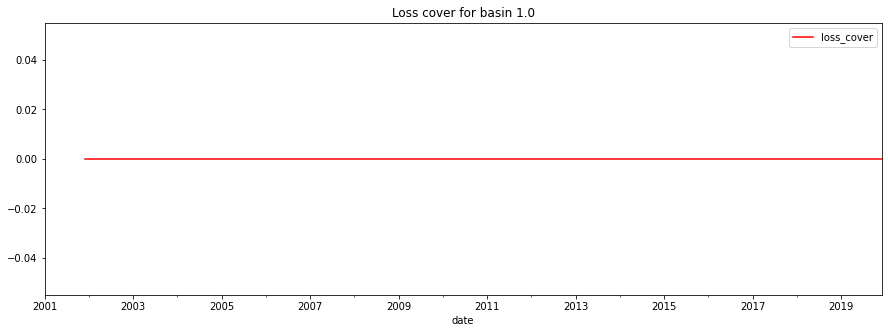

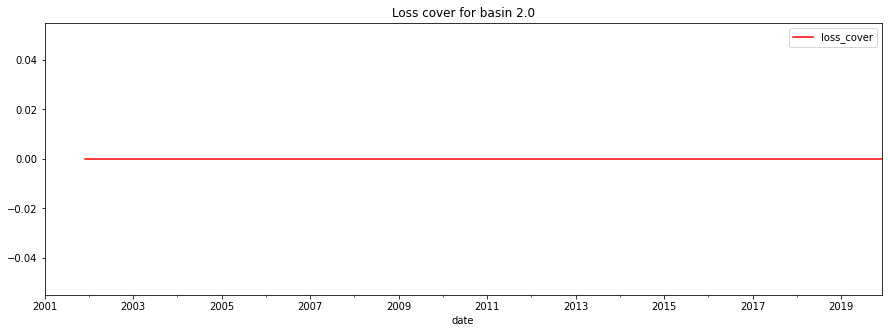

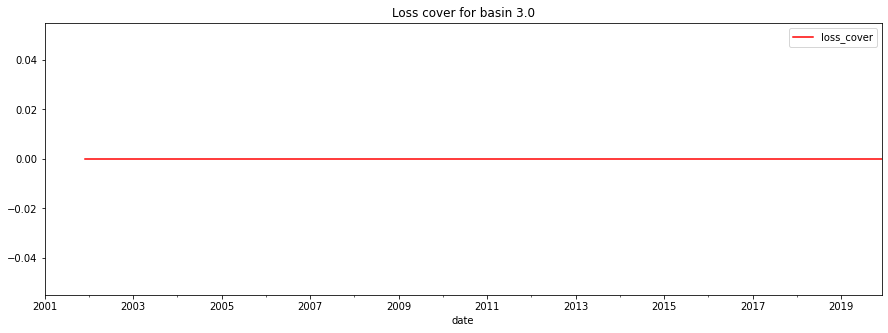

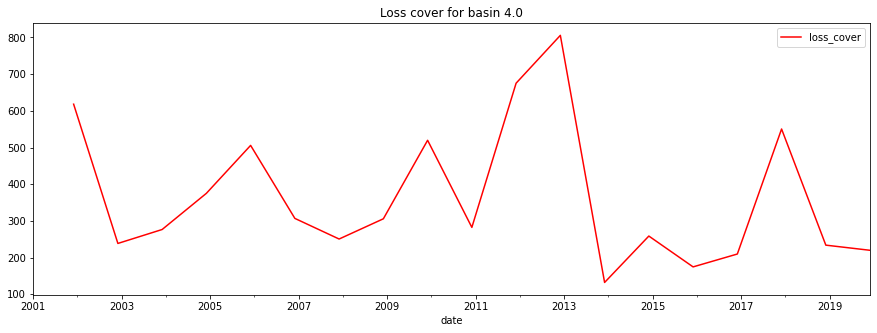

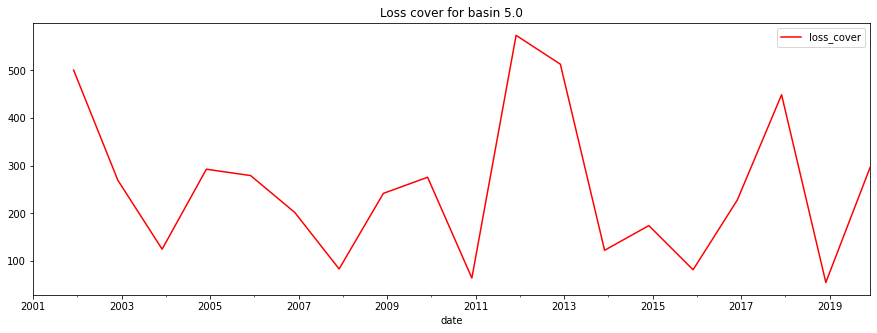

...

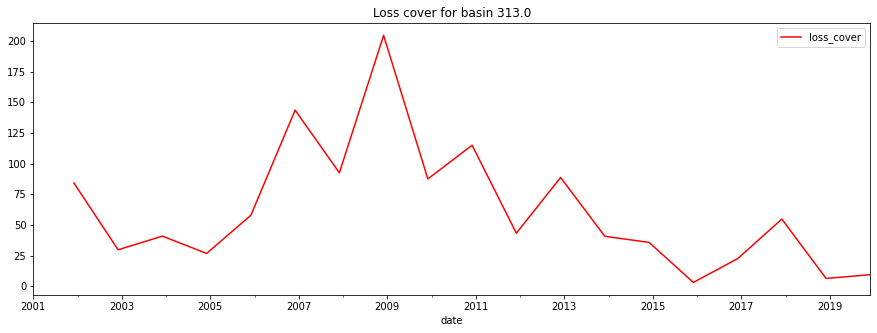

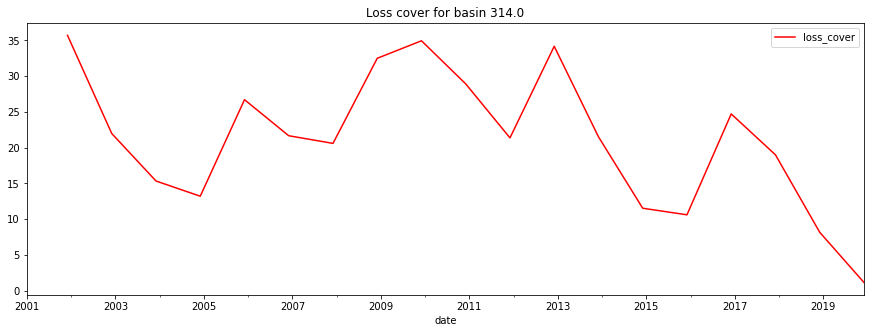

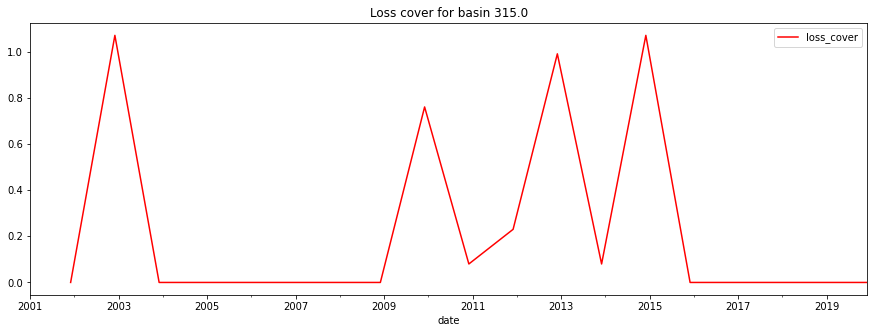

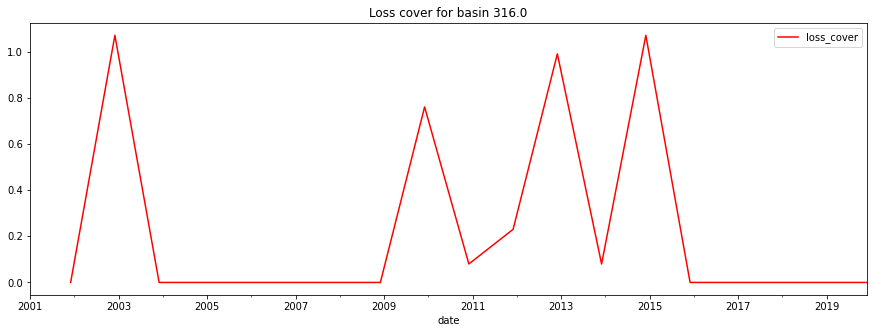

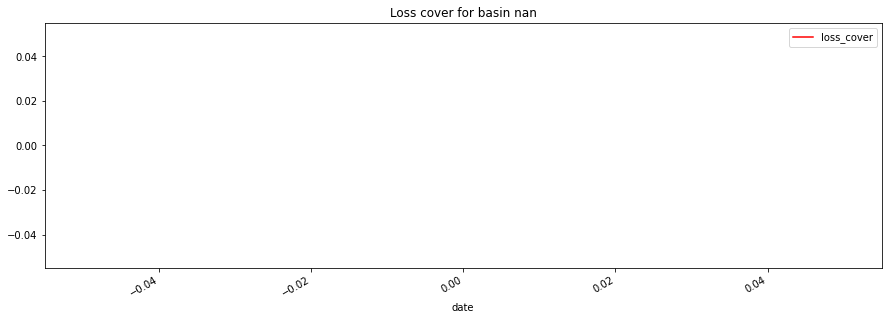

            basin_id  year  loss_cover  month         type
date                                                      
2001-01-31       1.0  2001         NaN      1  interpolate
2001-02-28       1.0  2001         NaN      2  interpolate
2001-03-31       1.0  2001         NaN      3  interpolate
2001-04-30       1.0  2001         NaN      4  interpolate
2001-05-31       1.0  2001         NaN      5  interpolate


In [13]:
temp_df = basins_fcl

temp_df['basin_id'] = pd.to_numeric(temp_df['basin_id'])
temp_df['year'] = pd.to_numeric(temp_df['year'])

temp_df = pd.merge(temp_df, month_seq, how = 'outer', on = 'year')

temp_df.sort_values(by = ['basin_id', 'year', 'month'], inplace = True)

temp_df['month'] = pd.to_numeric(temp_df['month'])
temp_df.loc[temp_df['month'] < 12,'loss_cover'] = np.nan
temp_df.loc[(temp_df['year'] == 2000) & 
            (temp_df['month'] == 12),'loss_cover'] = 0

temp_df['type'] = 'real'
temp_df.loc[temp_df['month'] < 12,'type'] = 'interpolate'

list_basins = temp_df.basin_id.unique()

# Plotting

temp_df_list = []

for i in list_basins:
    temp_df_basin = temp_df[temp_df['basin_id'] == i].copy()
    #temp_df_basin.interpolate(method = 'polynomial', order = 3, inplace = True)
    temp_df_basin.interpolate(method = 'linear', inplace = True)
    temp_df_basin.set_index(keys = ['date'], inplace = True, drop = True)
    temp_df_list.append(temp_df_basin)
    
    main_title = 'Loss cover for basin ' + str(i)
    fig, axes = plt.subplots(figsize=(15,5))
    temp_df_basin.plot(y = 'loss_cover', title = main_title, color = 'red', ax = axes)
    plt.show()

temp_df = pd.concat(temp_df_list)
temp_df.to_csv('tempo.csv')

basins_fcl = temp_df.copy()
print(basins_fcl.head())

### Variable FCL %

In [14]:
basins_fcl_perc_hz = basins_org[['objectid_1', 'FCL 2001 (%)', 'FCL 2002 (%)', 
                            'FCL 2003 (%)', 'FCL 2004 (%)', 'FCL 2005 (%)', 
                            'FCL 2006 (%)', 'FCL 2007 (%)', 'FCL 2008 (%)', 
                            'FCL 2009 (%)', 'FCL 2010 (%)', 'FCL 2011 (%)', 
                            'FCL 2012 (%)', 'FCL 2013 (%)', 'FCL 2014 (%)', 
                            'FCL 2015 (%)', 'FCL 2016 (%)', 'FCL 2017 (%)', 
                            'FCL 2018 (%)', 'FCL 2019 (%)', 
]]

basins_fcl_perc_hz.columns = ['basin_id', '2001', '2002', '2003', '2004', '2005', 
                           '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013', 
                           '2014', '2015', '2016', '2017', '2018', '2019']

basins_fcl_perc_hz = basins_fcl_perc_hz.replace({'%':''}, regex=True)
basins_fcl_perc_hz = basins_fcl_perc_hz.astype(float)
basins_fcl_perc_hz = basins_fcl_perc_hz.astype({'basin_id' : 'int64'})

basins_fcl_perc_hz.head()

,basin_id,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,1,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1,2,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,3,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
3,4,0.663,0.256,0.297,0.402,0.542,0.329,0.269,0.328,0.557,0.303,0.724,0.864,0.142,0.277,0.187,0.225,0.590,0.251,0.236
4,5,0.543,0.292,0.135,0.317,0.303,0.219,0.090,0.262,0.299,0.070,0.622,0.556,0.133,0.189,0.088,0.247,0.487,0.060,0.321


In [15]:
basins_fcl_perc = pd.melt(basins_fcl_perc_hz, id_vars = ['basin_id'], 
                       value_vars = ['2001', '2002', '2003', '2004', '2005', '2006', 
                                     '2007', '2008', '2009', '2010', '2011', '2012', 
                                     '2013', '2014', '2015', '2016', '2017', '2018', 
                                     '2019']).copy()

basins_fcl_perc.columns = ['basin_id', 'year', 'loss_cover']

print(basins_fcl_perc)

      basin_id  year  loss_cover
0            1  2001       0.000
1            2  2001       0.000
2            3  2001       0.000
3            4  2001       0.663
4            5  2001       0.543
...        ...   ...         ...
5999       312  2019       0.352
6000       313  2019       0.007
6001       314  2019       0.001
6002       315  2019       0.000
6003       316  2019       0.000

[6004 rows x 3 columns]


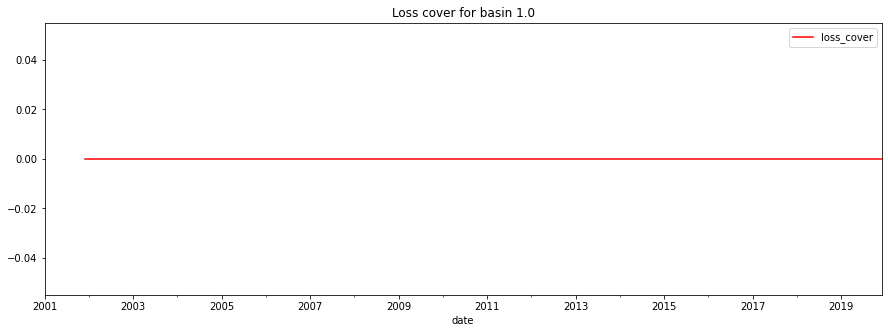

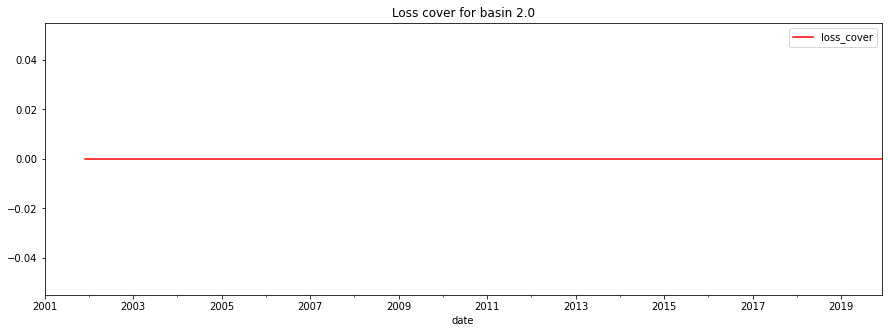

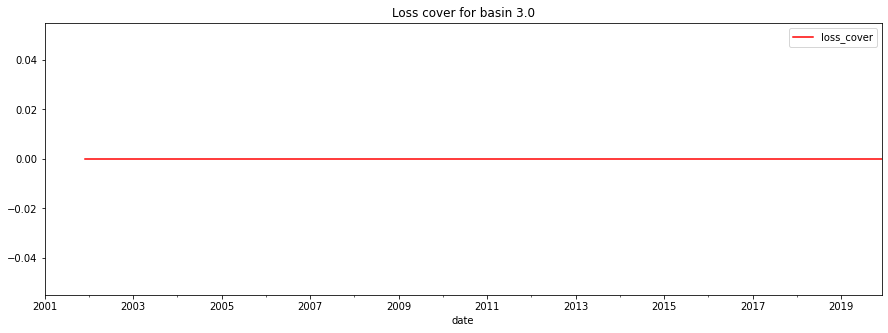

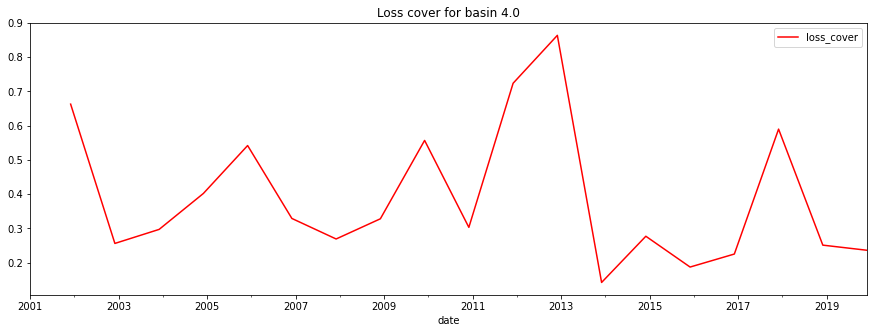

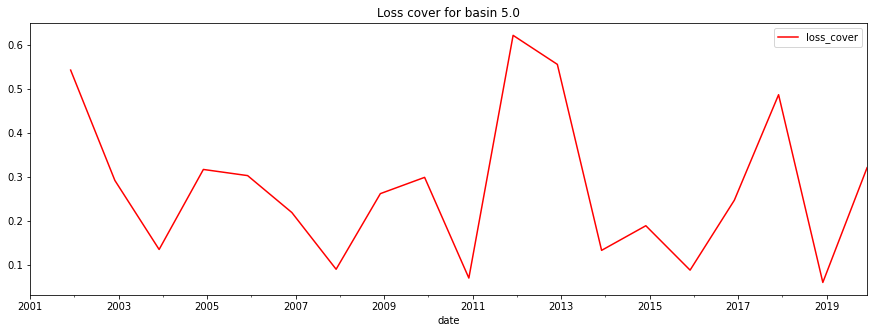

...

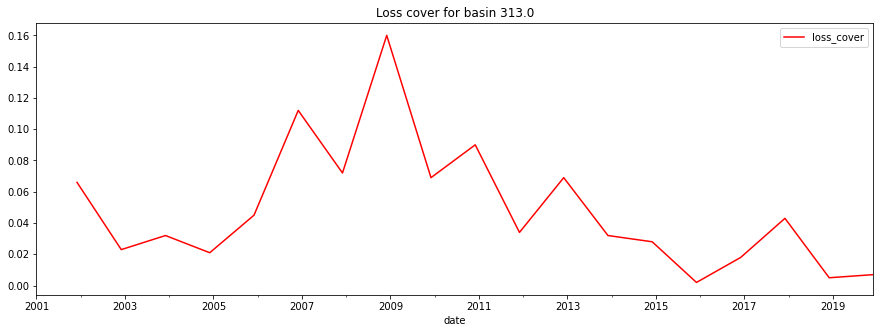

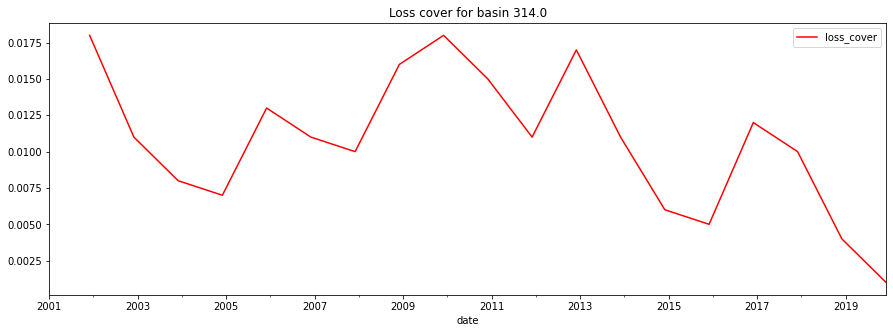

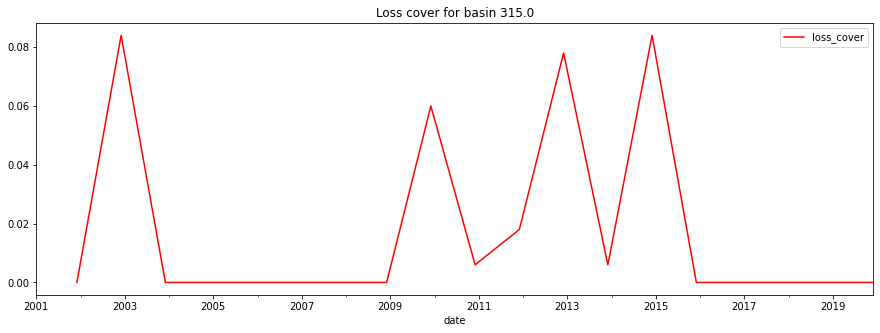

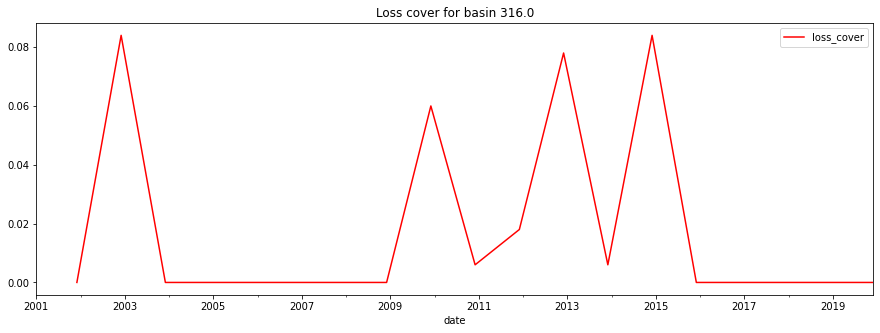

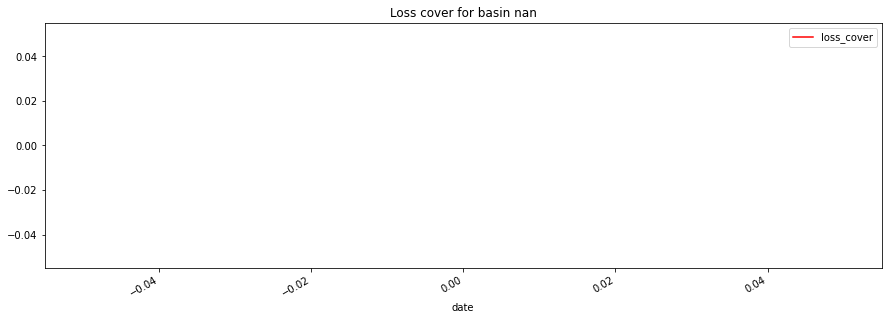

            basin_id  year  loss_cover  month         type
date                                                      
2001-01-31       1.0  2001         NaN      1  interpolate
2001-02-28       1.0  2001         NaN      2  interpolate
2001-03-31       1.0  2001         NaN      3  interpolate
2001-04-30       1.0  2001         NaN      4  interpolate
2001-05-31       1.0  2001         NaN      5  interpolate


In [16]:
temp_df = basins_fcl_perc
temp_df['basin_id'] = pd.to_numeric(temp_df['basin_id'])
temp_df['year'] = pd.to_numeric(temp_df['year'])

temp_df = pd.merge(temp_df, month_seq, how = 'outer', on = 'year')

temp_df.sort_values(by = ['basin_id', 'year', 'month'], inplace = True)

temp_df['month'] = pd.to_numeric(temp_df['month'])
temp_df.loc[temp_df['month'] < 12,'loss_cover'] = np.nan
temp_df.loc[(temp_df['year'] == 2000) & 
            (temp_df['month'] == 12),'loss_cover'] = 0

temp_df['type'] = 'real'
temp_df.loc[temp_df['month'] < 12,'type'] = 'interpolate'

list_basins = temp_df.basin_id.unique()

# Plotting

temp_df_list = []

for i in list_basins:
    temp_df_basin = temp_df[temp_df['basin_id'] == i].copy()
    #temp_df_basin.interpolate(method = 'polynomial', order = 3, inplace = True)
    temp_df_basin.interpolate(method = 'linear', inplace = True)
    temp_df_basin.set_index(keys = ['date'], inplace = True, drop = True)
    temp_df_list.append(temp_df_basin)
    
    main_title = 'Loss cover for basin ' + str(i)
    fig, axes = plt.subplots(figsize=(15,5))
    temp_df_basin.plot(y = 'loss_cover', title = main_title, color = 'red', ax = axes)
    plt.show()

temp_df = pd.concat(temp_df_list)
temp_df.to_csv('tempo.csv')

basins_fcl_perc = temp_df.copy()
print(basins_fcl_perc.head())

### Variable FCL % ACUM

In [17]:
basins_fcl_p_acum_hz = basins_org[['objectid_1', 'FCL 2001 (% acum)', 'FCL 2002 (% acum)', 
                                   'FCL 2003 (% acum)', 'FCL 2004 (% acum)', 
                                   'FCL 2005 (% acum)', 'FCL 2006 (% acum)', 
                                   'FCL 2007 (% acum)', 'FCL 2008 (% acum)', 
                                   'FCL 2009 (% acum)', 'FCL 2010 (% acum)', 
                                   'FCL 2011 (% acum)', 'FCL 2012 (% acum)', 
                                   'FCL 2013 (% acum)', 'FCL 2014 (% acum)', 
                                   'FCL 2015 (% acum)', 'FCL 2016 (% acum)', 
                                   'FCL 2017 (% acum)', 'FCL 2018 (% acum)', 
                                   'FCL 2019 (% acum)', 
]]

basins_fcl_p_acum_hz.columns = ['basin_id', '2001', '2002', '2003', '2004', '2005', '2006',
                                '2007', '2008', '2009', '2010', '2011', '2012', '2013', 
                                '2014', '2015', '2016', '2017', '2018', '2019']

basins_fcl_p_acum_hz = basins_fcl_p_acum_hz.replace({'%':''}, regex=True)
basins_fcl_p_acum_hz = basins_fcl_p_acum_hz.astype(float)

basins_fcl_p_acum_hz.head()

,basin_id,2001,2002,2003,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019
0,1.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
1,2.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,3.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
3,4.0,0.663,0.919,1.215,1.617,2.160,2.489,2.757,3.085,3.643,3.945,4.670,5.534,5.675,5.953,6.140,6.365,6.955,7.206,7.442
4,5.0,0.543,0.835,0.970,1.288,1.591,1.809,1.899,2.162,2.461,2.530,3.153,3.709,3.842,4.031,4.119,4.366,4.853,4.913,5.234


In [18]:
basins_fcl_p_acum = pd.melt(basins_fcl_p_acum_hz, id_vars = ['basin_id'], 
                       value_vars = ['2001', '2002', '2003', '2004', '2005', '2006', 
                                     '2007', '2008', '2009', '2010', '2011', '2012', 
                                     '2013', '2014', '2015', '2016', '2017', '2018', 
                                     '2019']).copy()

basins_fcl_p_acum.columns = ['basin_id', 'year', 'loss_cover']

print(basins_fcl_p_acum)

      basin_id  year  loss_cover
0          1.0  2001       0.000
1          2.0  2001       0.000
2          3.0  2001       0.000
3          4.0  2001       0.663
4          5.0  2001       0.543
...        ...   ...         ...
5999     312.0  2019       5.866
6000     313.0  2019       0.930
6001     314.0  2019       0.203
6002     315.0  2019       0.335
6003     316.0  2019       0.335

[6004 rows x 3 columns]


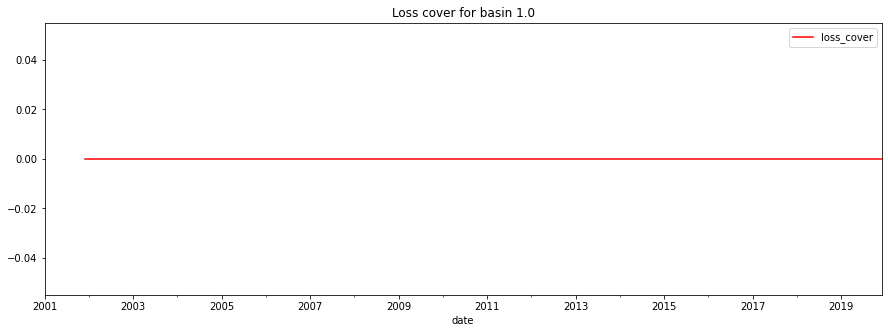

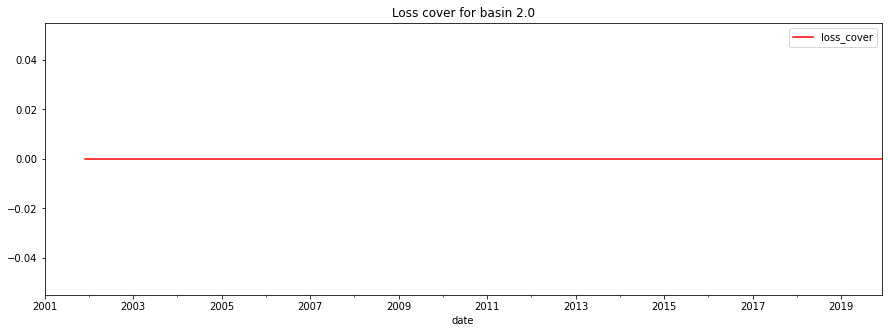

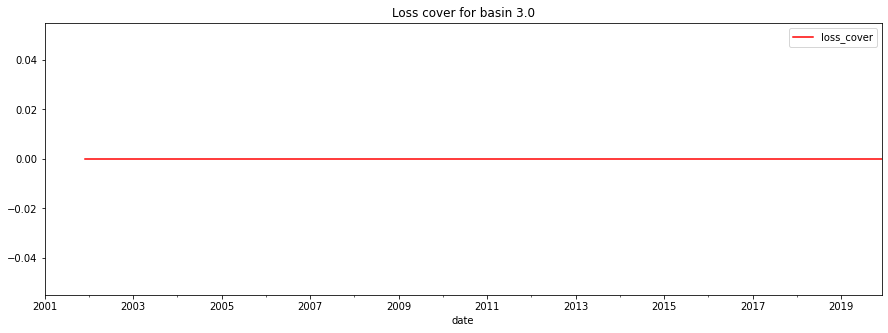

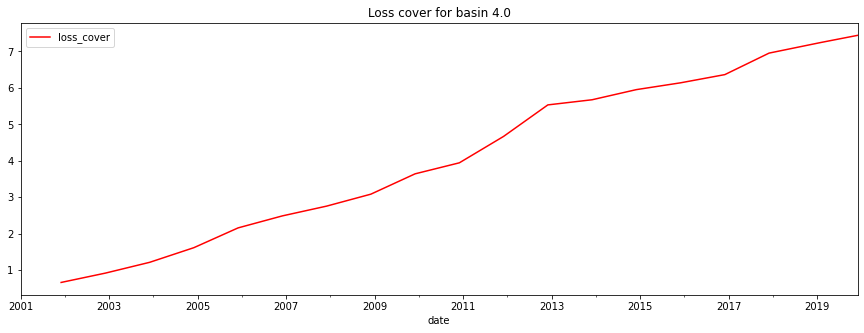

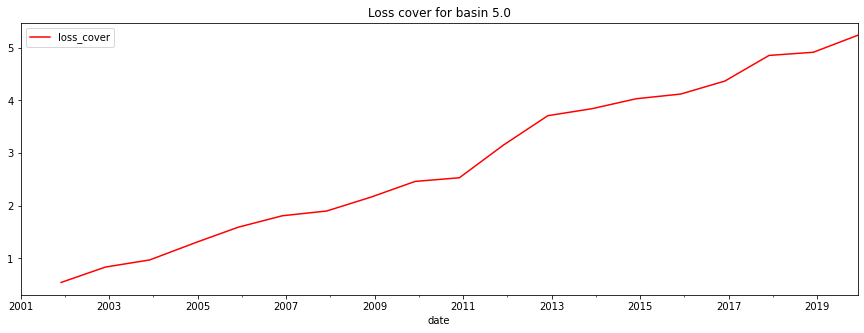

...

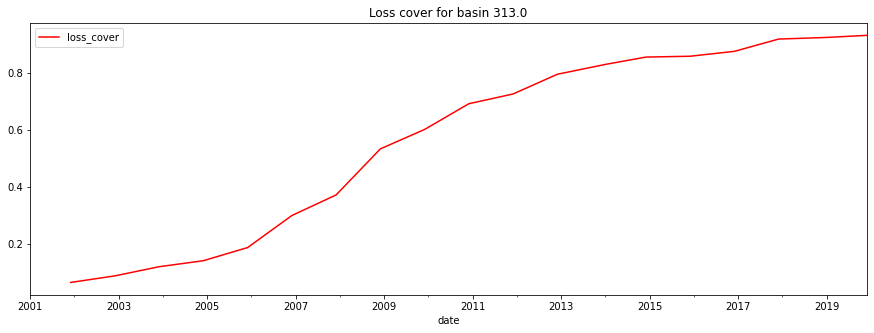

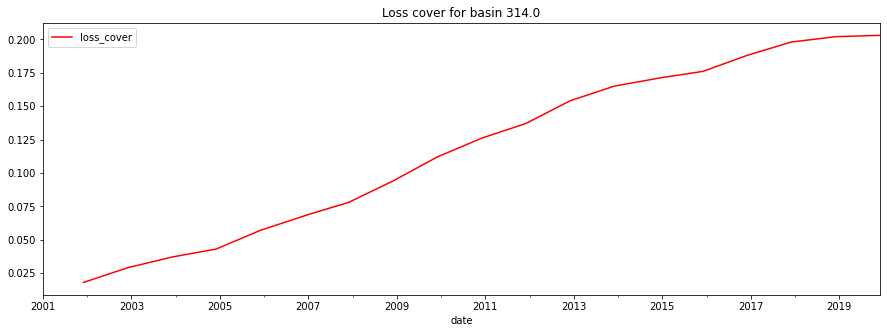

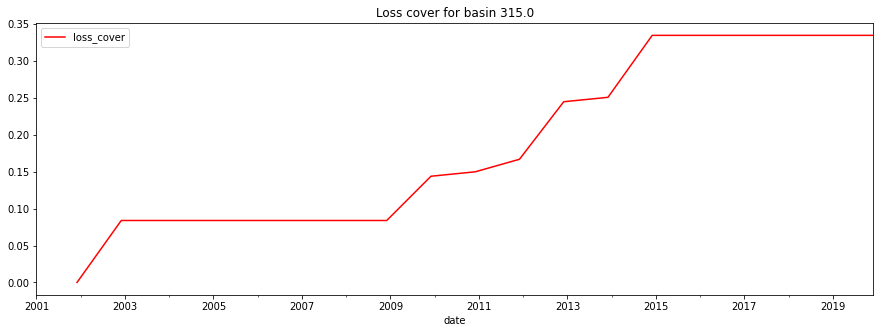

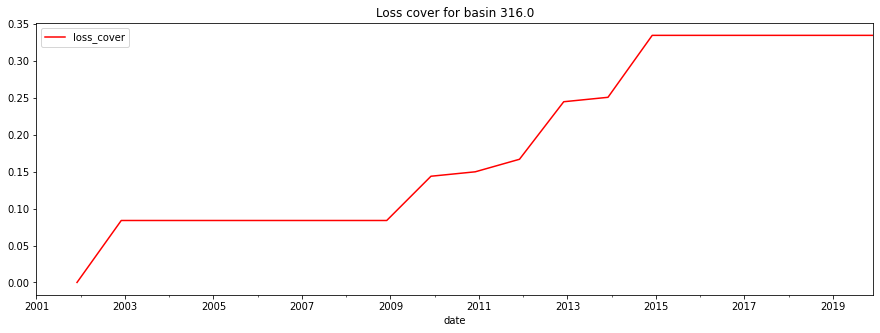

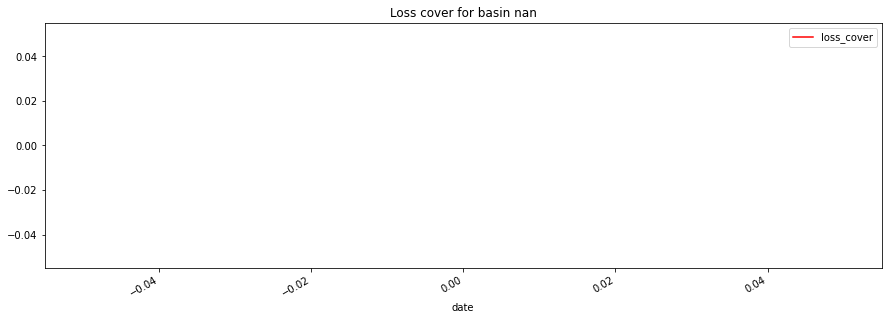

            basin_id  year  loss_cover  month         type
date                                                      
2001-01-31       1.0  2001         NaN      1  interpolate
2001-02-28       1.0  2001         NaN      2  interpolate
2001-03-31       1.0  2001         NaN      3  interpolate
2001-04-30       1.0  2001         NaN      4  interpolate
2001-05-31       1.0  2001         NaN      5  interpolate


In [19]:
temp_df = basins_fcl_p_acum

temp_df['basin_id'] = pd.to_numeric(temp_df['basin_id'])
temp_df['year'] = pd.to_numeric(temp_df['year'])

temp_df = pd.merge(temp_df, month_seq, how = 'outer', on = 'year')

temp_df.sort_values(by = ['basin_id', 'year', 'month'], inplace = True)

temp_df['month'] = pd.to_numeric(temp_df['month'])
temp_df.loc[temp_df['month'] < 12,'loss_cover'] = np.nan
temp_df.loc[(temp_df['year'] == 2000) & 
            (temp_df['month'] == 12),'loss_cover'] = 0

temp_df['type'] = 'real'
temp_df.loc[temp_df['month'] < 12,'type'] = 'interpolate'

list_basins = temp_df.basin_id.unique()

# Plotting

temp_df_list = []

for i in list_basins:
    temp_df_basin = temp_df[temp_df['basin_id'] == i].copy()
    #temp_df_basin.interpolate(method = 'polynomial', order = 3, inplace = True)
    temp_df_basin.interpolate(method = 'linear', inplace = True)
    temp_df_basin.set_index(keys = ['date'], inplace = True, drop = True)
    temp_df_list.append(temp_df_basin)
    
    main_title = 'Loss cover for basin ' + str(i)
    fig, axes = plt.subplots(figsize=(15,5))
    temp_df_basin.plot(y = 'loss_cover', title = main_title, color = 'red', ax = axes)
    plt.show()

temp_df = pd.concat(temp_df_list)
temp_df.to_csv('tempo.csv')

basins_fcl_p_acum = temp_df.copy()
print(basins_fcl_p_acum.head())

### Consolidation

In [41]:
#temp_df = pd.merge(basins_descr, month_seq, how = 'outer', on = None)

basins_fcl['basin_id'] = basins_fcl['basin_id'].astype(int)
basins_fcl_perc['basin_id'] = basins_fcl_perc['basin_id'].astype(int)
basins_fcl_p_acum['basin_id'] = basins_fcl_p_acum['basin_id'].astype(int)

#print('basins_descr', '\n', basins_descr.dtypes, '\n')
#print('basins_histo', '\n', basins_histo.dtypes, '\n')
#print('basins_fcl', '\n', basins_fcl.dtypes, '\n')
#print('basins_fcl_perc', '\n', basins_fcl_perc.dtypes, '\n')
#print('basins_fcl_p_acum', '\n', basins_fcl_p_acum.dtypes, '\n')

temp_df = pd.merge(basins_descr, basins_histo, how = 'left', 
                   left_on = ['basin_id'],
                   right_on = ['basin_id'])
temp_df = pd.merge(temp_df, basins_fcl, how = 'left', 
                   on = ['basin_id', 'year', 'month'])
temp_df = pd.merge(temp_df, basins_fcl_perc, how = 'left', 
                   on = ['basin_id', 'year', 'month'])
temp_df = pd.merge(temp_df, basins_fcl_p_acum, how = 'left', 
                   on = ['basin_id', 'year', 'month'])

print(temp_df.shape)
print(temp_df.columns)

temp_df.columns = ['basin_id', 'cod_ah', 'nom_ah', 'cod_szh', 'nom_szh', 'cod_zh',
                   'nom_zh', 'ruleid', 'shape_area', 'shape_leng', 'basin_area', 
                   'year', 'loss_cover_histo', 'month', 'type', 'loss_cover_fcl', 
                   'type_y', 'loss_cover_fcl_perc', 'type_x', 'loss_cover_perc_acum', 
                   'type_y']

temp_df = temp_df[['basin_id', 'cod_ah', 'nom_ah', 'cod_szh', 'nom_szh', 'cod_zh',
                   'nom_zh', 'ruleid', 'shape_area', 'shape_leng', 'basin_area', 
                   'year', 'month', 'type', 'loss_cover_histo', 'loss_cover_fcl', 
                   'loss_cover_fcl_perc', 'loss_cover_perc_acum']]

temp_df.to_csv('../data/variables/FCL316Basins_month.csv', index = False)

temp_df.head()

(75840, 21)
Index(['basin_id', 'cod_ah', 'nom_ah', 'cod_szh', 'nom_szh', 'cod_zh',
       'nom_zh', 'ruleid', 'shape_area', 'shape_leng', 'basin_area', 'year',
       'loss_cover_x', 'month', 'type_x', 'loss_cover_y', 'type_y',
       'loss_cover_x', 'type_x', 'loss_cover_y', 'type_y'],
      dtype='object')


,basin_id,cod_ah,nom_ah,cod_szh,nom_szh,cod_zh,nom_zh,ruleid,shape_area,shape_leng,basin_area,year,month,type,loss_cover_histo,loss_cover_fcl,loss_cover_fcl_perc,loss_cover_perc_acum
0,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2000,1,interpolate,NaN,NaN,NaN,NaN
1,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2000,2,interpolate,NaN,NaN,NaN,NaN
2,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2000,3,interpolate,NaN,NaN,NaN,NaN
3,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2000,4,interpolate,NaN,NaN,NaN,NaN
4,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2000,5,interpolate,NaN,NaN,NaN,NaN


### Annual summary

In [42]:
temp_df = temp_df[temp_df['month'] == 12]

del temp_df['month']

print(temp_df.shape)
print(temp_df.columns)

temp_df.to_csv('../data/variables/FCL316Basins_year.csv', index = False)

temp_df.head()

(6320, 17)
Index(['basin_id', 'cod_ah', 'nom_ah', 'cod_szh', 'nom_szh', 'cod_zh',
       'nom_zh', 'ruleid', 'shape_area', 'shape_leng', 'basin_area', 'year',
       'type', 'loss_cover_histo', 'loss_cover_fcl', 'loss_cover_fcl_perc',
       'loss_cover_perc_acum'],
      dtype='object')


,basin_id,cod_ah,nom_ah,cod_szh,nom_szh,cod_zh,nom_zh,ruleid,shape_area,shape_leng,basin_area,year,type,loss_cover_histo,loss_cover_fcl,loss_cover_fcl_perc,loss_cover_perc_acum
11,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2000,real,0.0,NaN,NaN,NaN
23,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2001,real,0.0,0.0,0.0,0.0
35,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2002,real,0.0,0.0,0.0,0.0
47,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2003,real,0.0,0.0,0.0,0.0
59,1,1,Caribe,1701,San Andres,17,Islas Caribe,2,0.002232,0.358011,2683.774,2004,real,0.0,0.0,0.0,0.0
